## This code provides the user a way to determine where the crops of certain variety can be found within a department area of Senegal.  

Due to imbalance in crop production in certain areas, various people may want to know where they can find a crop or if they have a crop to sell/distribute where will there be a need.  

source code:  
https://automating-gis-processes.github.io/site/notebooks/L6/network-analysis.html  
https://github.com/gboeing/osmnx

### OSMnx  

This code primarily uses osmnx as the main library to implement the ability to find the location given certain inputs.  It uses the OSM, open street map, a collaborative tool used by anyone to identify information found in a map.

### Shapefile  

One of 2 inputs for this code is the use of shapefile geometries that create a boundary of interest within a map.  For this project, the shapefile was obtained from www.gadm.org and uses the level-2 administrative level or department level map boundary for Senegal.

In [40]:
# osmnx libraries
import osmnx as ox
import networkx as nx

# geospatial libraries
import geopandas as gpd
import fiona
from shapely.geometry import Point

# primary python library
import matplotlib.pyplot as plt
import pandas as pd

#### Set the machine to the local system.

In [2]:
# built in python library
import os, sys

Below, change the block to identify the local path to the directory.

In [5]:
# set this to local dir
os.chdir()          # <----  enter the local directory where the shapefile is located

In [65]:
# extract the shapefile
# there should be 4 files with the following extensions:
#   .shp .shx .prj .dbf (optinally .cpg)
# only the .shp is required to read into the code and the others will automatically be used.
#shape_file_4_senegal =      # <--- enter here the full name and path of shapefile

In [7]:
df = gpd.read_file(shape_file_4_senegal)
df.head(3)

,GID_0,NAME_0,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
0,SEN,Senegal,SEN.1_1,Dakar,None,SEN.1.1_1,Dakar,None,None,Département,Department,11,SN.DK.DK,"MULTIPOLYGON (((-17.46736 14.65097, -17.46736 ..."
1,SEN,Senegal,SEN.1_1,Dakar,None,SEN.1.2_1,Guédiawaye,None,None,Département,Department,14,SN.DK.GD,"POLYGON ((-17.40012 14.75731, -17.40051 14.757..."
2,SEN,Senegal,SEN.1_1,Dakar,None,SEN.1.3_1,Pikine,None,None,Département,Department,12,SN.DK.PK,"POLYGON ((-17.39897 14.73781, -17.39903 14.737..."


In [8]:
# identify all the departments included in this shapefile
df.groupby(['NAME_2']).count()

,GID_0,NAME_0,GID_1,NAME_1,NL_NAME_1,GID_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
NAME_2,,,,,,,,,,,,,
Bakel,1,1,1,1,0,1,0,0,1,1,1,1,1
Bambey,1,1,1,1,0,1,0,0,1,1,1,1,1
Bignona,1,1,1,1,0,1,0,0,1,1,1,1,1
Birkilane,1,1,1,1,0,1,0,0,1,1,1,1,1
Bounkiling,1,1,1,1,0,1,0,0,1,1,1,1,1
Dagana,1,1,1,1,0,1,0,0,1,1,1,1,1
Dakar,1,1,1,1,0,1,0,0,1,1,1,1,1
Diourbel,1,1,1,1,0,1,0,0,1,1,1,1,1
Fatick,1,1,1,1,0,1,0,0,1,1,1,1,1


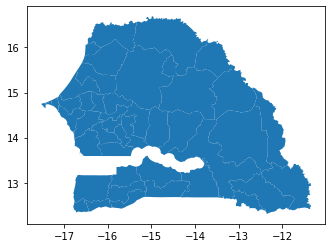

In [10]:
# plot the shapefile to ensure it is the proper map
df.plot();

## Crop Data  

From Task 1 & 4, this code will utilize information that would show the crop yield unto the map.  The data is sectioned at the department level.  For simplicity in demonstrating this code, the first department from that list will be used.  

Bignona

In [11]:
# find the department
aoi = df[ df['NAME_2'] == 'Bignona']

In [12]:
aoi

,GID_0,NAME_0,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
42,SEN,Senegal,SEN.14_1,Ziguinchor,None,SEN.14.1_1,Bignona,None,None,Département,Department,21,SN.ZG.BG,"POLYGON ((-16.33970 12.59094, -16.34010 12.590..."


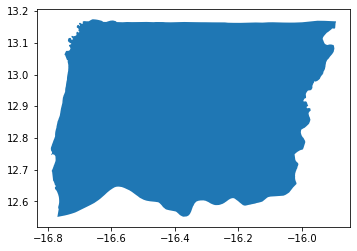

In [17]:
# Display the map of the selected department for this testing:
c = fiona.open(shape_file_4_senegal)
d = gpd.GeoDataFrame.from_features(c[42:43])
d.plot();

In [18]:
# we can also find the region it belongs
region_sen = df[ df['NAME_1'] == 'Ziguinchor']

In [19]:
region_sen

,GID_0,NAME_0,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
42,SEN,Senegal,SEN.14_1,Ziguinchor,None,SEN.14.1_1,Bignona,None,None,Département,Department,21,SN.ZG.BG,"POLYGON ((-16.33970 12.59094, -16.34010 12.590..."
43,SEN,Senegal,SEN.14_1,Ziguinchor,None,SEN.14.2_1,Oussouye,None,None,Département,Department,22,SN.ZG.OU,"POLYGON ((-16.45373 12.43734, -16.45239 12.436..."
44,SEN,Senegal,SEN.14_1,Ziguinchor,None,SEN.14.3_1,Ziguinchor,None,None,Département,Department,23,SN.ZG.ZG,"POLYGON ((-15.93625 12.52574, -15.93569 12.525..."


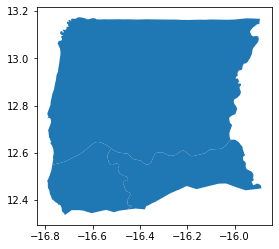

In [20]:
# from the shapefile, the region has 3 departments at index location 42, 43, 44
# enter these numbers to plot only that region
c_reg = fiona.open(shape_file_4_senegal)
d_reg = gpd.GeoDataFrame.from_features(c_reg[42:45])    # python will not count the last index
d_reg.plot();

## This section will now extract the shapefile data for its roads, composed of nodes and edges to represent intersection and roads.

In [21]:
polygon = aoi['geometry'].iloc[0]

In [22]:
# only want the main network in order to reduce the computation reguired for the algorithm
G = ox.graph_from_polygon(polygon, custom_filter='["highway"~"motorway|motorway_link|trunk|trunk_link|primary|primary_link|secondary|secondary_link|tertiary|tertiary_link|unclassified|residential|living_street"]')

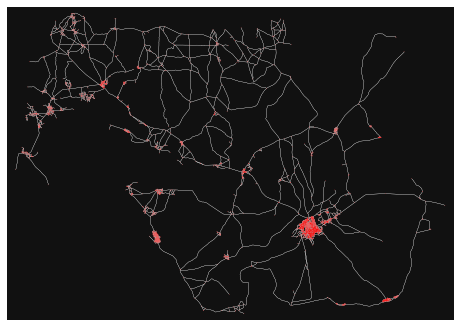

In [23]:
# plot the nodes/edges from the shapefile
fig, ax = ox.plot_graph(G, node_color='r',node_size=0.2, edge_color='w', edge_linewidth=0.2)

In [24]:
# Retrieve only edges from the graph
edges = ox.graph_to_gdfs(G, nodes=False, edges=True)

In [25]:
# Check columns
edges.columns

Index(['osmid', 'oneway', 'highway', 'length', 'geometry', 'bridge', 'lanes',
       'name', 'ref', 'maxspeed', 'access', 'service', 'junction'],
      dtype='object')

### crs  
This attribute is a key standard projection reference system used to project a 3D sphere into a flat map.  This will be used later to transform crop data unto this map.

In [26]:
# Check crs
edges.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [27]:
# display content
edges.head(2)

osmid  oneway   highway   length  \
u          v          key                                         
1764095232 1786707980 0    374911717   False  tertiary  216.996   
           1786708025 0    374911717   False  tertiary  111.350   

                                                                    geometry  \
u          v          key                                                      
1764095232 1786707980 0    LINESTRING (-16.37848 12.74489, -16.38026 12.7...   
           1786708025 0    LINESTRING (-16.37848 12.74489, -16.37796 12.7...   

                          bridge lanes name  ref maxspeed access service  \
u          v          key                                                  
1764095232 1786707980 0      NaN   NaN  NaN  NaN      NaN    NaN     NaN   
           1786708025 0      NaN   NaN  NaN  NaN      NaN    NaN     NaN   

                          junction  
u          v          key           
1764095232 1786707980 0        NaN  
           1786708025 0        NaN

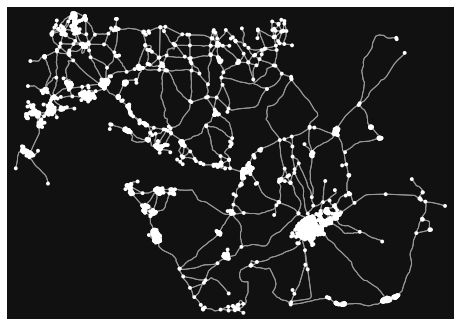

In [28]:
# use intermediate variable
graph_proj = ox.project_graph(G)
fig, ax = ox.plot_graph(graph_proj)

In [29]:
# Get Edges and Nodes
nodes_proj, edges_proj = ox.graph_to_gdfs(graph_proj, nodes=True, edges=True)

In [31]:
# verify the projection and coordinate system
print("Coordinate system:", edges_proj.crs)

Coordinate system: +proj=utm +zone=28 +ellps=WGS84 +datum=WGS84 +units=m +no_defs +type=crs


In [32]:
# display data
edges_proj.head(3)

osmid  oneway      highway   length  \
u          v          key                                            
1764095232 1786707980 0    374911717   False     tertiary  216.996   
           1786708025 0    374911717   False     tertiary  111.350   
           7390943782 0    790569245   False  residential  169.766   

                                                                    geometry  \
u          v          key                                                      
1764095232 1786707980 0    LINESTRING (350351.639 1409321.751, 350157.973...   
           1786708025 0    LINESTRING (350351.639 1409321.751, 350407.550...   
           7390943782 0    LINESTRING (350351.639 1409321.751, 350323.623...   

                          bridge lanes maxspeed  ref name access junction  \
u          v          key                                                   
1764095232 1786707980 0      NaN   NaN      NaN  NaN  NaN    NaN      NaN   
           1786708025 0      NaN   NaN      NaN  NaN  NaN    NaN      NaN   
           7390943782 0      NaN   NaN      NaN  NaN  NaN    NaN      NaN   

                          service  
u          v          key          
1764095232 1786707980 0       NaN  
           1786708025 0       NaN  
           7390943782 0       NaN

In [33]:
# Calculate network statistics
# information that will be useful for verification or look up 
stats = ox.basic_stats(graph_proj, circuity_dist='euclidean')
stats

{'n': 4551,
 'm': 13881,
 'k_avg': 6.100197758734344,
 'intersection_count': 4071,
 'streets_per_node_avg': 3.065260382333553,
 'streets_per_node_counts': {0: 0, 1: 480, 2: 2, 3: 2819, 4: 1241, 5: 9},
 'streets_per_node_proportion': {0: 0.0,
  1: 0.1054713249835201,
  2: 0.00043946385409800046,
  3: 0.6194243023511317,
  4: 0.2726873214678093,
  5: 0.001977587343441002},
 'edge_length_total': 4025166.9030000046,
 'edge_length_avg': 289.97672379511596,
 'street_length_total': 2013333.055999994,
 'street_length_avg': 289.06432964824035,
 'street_segments_count': 6965,
 'node_density_km': None,
 'intersection_density_km': None,
 'edge_density_km': None,
 'street_density_km': None,
 'circuity_avg': 1.0558009139293414,
 'self_loop_proportion': 0.00014408183848425905,
 'clean_intersection_count': None,
 'clean_intersection_density_km': None}

In [34]:
# display node data
nodes_proj.head(3)

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
1764095232,1.409322e+06,350351.639337,4,-16.378478,12.744892,NaN,POINT (350351.639 1409321.751)
1786707980,1.409224e+06,350157.972585,3,-16.380257,12.743999,NaN,POINT (350157.973 1409223.955)
1786708025,1.409372e+06,350450.760845,3,-16.377568,12.745353,NaN,POINT (350450.761 1409372.241)


## This section will now determine the end points of two locations.  
If a user starts at one location and would like to find the shortest distance to another location, the following code would produce this information.

#### First, obtain the end location: a random location at the eastern most side of the department area.  This is for testing only.

In [35]:
# Get the x coordinates of the nodes
nodes_proj['x'] = nodes_proj["x"].astype(float)

In [36]:
# Retrieve the maximum x value (i.e. the most eastern)
maxx = nodes_proj['x'].max()
print(maxx)

392938.86855831527


In [37]:
# Retrieve the node that is the most eastern one and get the Shapely Point geometry out of it
target = nodes_proj.loc[nodes_proj['x']==maxx, 'geometry'].values[0]
print(target)

POINT (392938.8685583153 1419370.686318934)


In [49]:
# Get target x and y coordinates
target_xy = (target.y, target.x)

## This section will introduce the crop data and its location.  

For simplicity, the first data from the list is taken with its lat/lon, latitude and longitude, coordinates.  This also corresponds to the department/region of interest.

The crop data comes from Task 4, MERGE_1_maize_weather_merge_inner_2014.csv  

Depending on how this code is used, the type of user input will be determined then.  For the current testing, the coordinates are entered manually.

#### This part of the algorithm is taking the coordinate location of another source, crop data, and it is projected, osmnx transformation, into the graph used, in this case, the shapefile information.  

source code: https://stackoverflow.com/questions/63245142/transform-lat-long-coordinates-for-a-osmnx-projected-map

In [41]:
# turn lat/lng lists into list of shapely points
lats = [12.74920333]
lngs = [-16.04972]
points_list = [Point((lng, lat)) for lat, lng in zip(lats, lngs)]

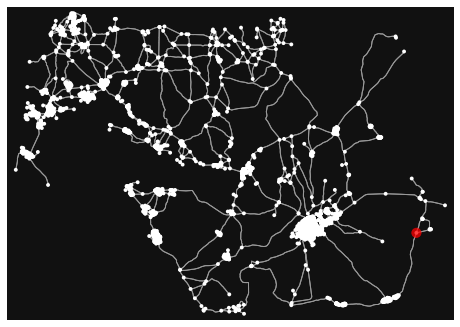

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [53]:
# or just plot the lat, lon on the map
ox.plot_graph_route(G, [ox.get_nearest_node(G, (12.74920333, -16.04972))])

In [42]:
# then turn list into GeoSeries with original CRS set
# i'm just guessing that your original CRS is 4326
points = gpd.GeoSeries(points_list, crs='epsg:4326')

In [43]:
# then project your points to the same CRS as your projected graph
points_proj = points.to_crs(graph_proj.graph['crs'])

#### The crop coordinates are now projected into the shapefile graph.

In [44]:
points_proj.y.values[0]

1409631.7111414066

#### Now make this projection the origin of the network path.

In [45]:
# points_proj - code at end of this notebook
orig_xy = (points_proj.y.values[0], points_proj.x.values[0])

In [46]:
orig_xy

(1409631.7111414066, 386047.92148294667)

In [50]:
# Find the node in the graph that is closest to the origin point (here, we want to get the node id)
orig_node = ox.get_nearest_node(graph_proj, orig_xy, method='euclidean')
orig_node

1917676767

In [51]:
# Find the node in the graph that is closest to the target point (here, we want to get the node id)
target_node = ox.get_nearest_node(graph_proj, target_xy, method='euclidean')
target_node

293466202

In [52]:
# Retrieve the rows from the nodes GeoDataFrame
o_closest = nodes_proj.loc[orig_node]
t_closest = nodes_proj.loc[target_node]

In [54]:
# Create a GeoDataFrame from the origin and target points
od_nodes = gpd.GeoDataFrame([o_closest, t_closest], geometry='geometry', crs=nodes_proj.crs)
od_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
1917676767,1.414077e+06,387350.247810,3,-16.037888,12.789445,NaN,POINT (387350.248 1414077.251)
293466202,1.419371e+06,392938.868558,1,-15.986590,12.837503,NaN,POINT (392938.869 1419370.686)


In [55]:
# Calculate the shortest path
route = nx.shortest_path(G=graph_proj, source=orig_node, target=target_node, weight='length')

# Show what we have
print(route)

[1917676767, 1917677237, 6184720142, 1917676709, 293466202]


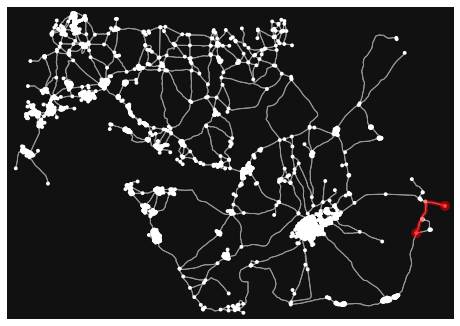

In [56]:
# Plot the shortest path
fig, ax = ox.plot_graph_route(graph_proj, route,  route_color='r', route_linewidth=4, route_alpha=0.5, orig_dest_size=100)

In [57]:
# Get the nodes along the shortest path
route_nodes = nodes_proj.loc[route]
route_nodes

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
1917676767,1.414077e+06,387350.247810,3,-16.037888,12.789445,NaN,POINT (387350.248 1414077.251)
1917677237,1.416707e+06,388471.632775,3,-16.027654,12.813266,NaN,POINT (388471.633 1416707.470)
6184720142,1.416898e+06,388485.818136,3,-16.027530,12.814991,NaN,POINT (388485.818 1416898.281)
1917676709,1.420213e+06,389122.661566,3,-16.021784,12.844981,NaN,POINT (389122.662 1420212.612)
293466202,1.419371e+06,392938.868558,1,-15.986590,12.837503,NaN,POINT (392938.869 1419370.686)


In [58]:
route_nodes['osmid'] = route_nodes.index
route_nodes.head(2)

,y,x,street_count,lon,lat,highway,geometry,osmid
osmid,,,,,,,,
1917676767,1.414077e+06,387350.247810,3,-16.037888,12.789445,NaN,POINT (387350.248 1414077.251),1917676767
1917677237,1.416707e+06,388471.632775,3,-16.027654,12.813266,NaN,POINT (388471.633 1416707.470),1917677237


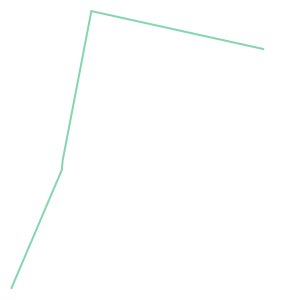

In [59]:
from shapely.geometry import LineString, Point

# Create a geometry for the shortest path
route_line = LineString(list(route_nodes.geometry.values))
route_line

In [60]:
# Create a GeoDataFrame
route_geom = gpd.GeoDataFrame([[route_line]], geometry='geometry', crs=edges_proj.crs, columns=['geometry'])

In [61]:
route_geom.head(2)

,geometry
0,"LINESTRING (387350.248 1414077.251, 388471.633..."


In [62]:
# Add a list of osmids associated with the route
route_geom.loc[0, 'osmids'] = str(list(route_nodes['osmid'].values))

# Calculate the route length
route_geom['length_m'] = route_geom.length

route_geom.head()

,geometry,osmids,length_m
0,"LINESTRING (387350.248 1414077.251, 388471.633...","[1917676767, 1917677237, 6184720142, 191767670...",10333.567611


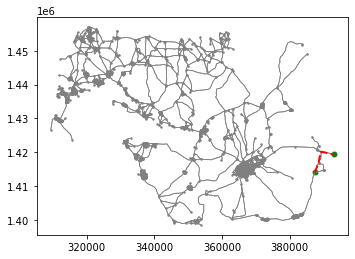

In [63]:
# Plot edges and nodes
ax = edges_proj.plot(linewidth=0.75, color='gray')
ax = nodes_proj.plot(ax=ax, markersize=2, color='gray')

# Add the route
ax = route_geom.plot(ax=ax, linewidth=2, linestyle='--', color='red')

# Add the origin and destination nodes of the route
ax = od_nodes.plot(ax=ax, markersize=24, color='green')